Problem description
Given a genre as input to a model, the model should attempt to generate a coherent story that fits the selected genre, such as fantasy, horror, or romance. The model is trained on a diverse dataset of stories from various genres in attempt to generate stories based on a genre. The model should be trained to understand and mimic the nuances, tone, and stylistic elements characteristic of the chosen genre. The primary objective is to create a system that can produce natural-sounding text consistent with the given genre, enabling applications such as automated content generation, storytelling, and dialogue generation

In [1]:
!pip freeze

accelerate==0.26.1
aiohttp==3.9.3
aiosignal==1.3.1
asttokens==2.4.1
attrs==23.2.0
certifi==2024.2.2
charset-normalizer==3.3.2
click==8.1.7
colorama==0.4.6
comm==0.2.1
contourpy==1.2.0
cycler==0.12.1
datasets==2.17.1
debugpy==1.8.1
decorator==5.1.1
dill==0.3.8
executing==2.0.1
filelock==3.13.1
fonttools==4.50.0
frozenlist==1.4.1
fsspec==2023.10.0
huggingface-hub==0.20.3
idna==3.6
ipykernel==6.29.2
ipython==8.22.1
jedi==0.19.1
Jinja2==3.1.3
joblib==1.3.2
jupyter_client==8.6.0
jupyter_core==5.7.1
kiwisolver==1.4.5
MarkupSafe==2.1.5
matplotlib==3.8.3
matplotlib-inline==0.1.6
mpmath==1.3.0
multidict==6.0.5
multiprocess==0.70.16
nest-asyncio==1.6.0
networkx==3.2.1
nltk==3.6.5
numpy==1.26.4
packaging==23.2
pandas==2.2.1
parso==0.8.3
pillow==10.2.0
platformdirs==4.2.0
prompt-toolkit==3.0.43
psutil==5.9.8
pure-eval==0.2.2
pyaml==23.12.0
pyarrow==15.0.0
pyarrow-hotfix==0.6
Pygments==2.17.2
pyparsing==3.1.2
python-dateutil==2.8.2
pytz==2024.1
pywin32==306
PyYAML==6.0.1
pyzmq==25.1.2
regex==2023.1

In [1]:
pip install accelerate==0.26.1
pip install torch torchvision torchaudio --index-url https://download.pytorch.org/whl/cu118
pip install datasets==2.17.1
pip install rouge==1.0.1

In [1]:
import torch
from accelerate import Accelerator
from transformers import GPT2Tokenizer, GPT2LMHeadModel
from transformers import TextDataset, DataCollatorForLanguageModeling,DataCollatorWithPadding
from transformers import Trainer, TrainingArguments
from transformers import pipeline
from datasets import load_dataset
import pandas as pd
import matplotlib.pyplot as plt
import re
from collections import Counter
from nltk.translate.bleu_score import sentence_bleu
from rouge import Rouge
import torch
import random
import string
from datasets import Dataset
from sklearn.model_selection import train_test_split

C:\Users\jayjo\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.12_qbz5n2kfra8p0\LocalCache\local-packages\Python312\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
accelerator = Accelerator()
device = accelerator.device
device

device(type='cuda')

Cleaning: The dataset is read into a data frame and removing rows with missing values in the story column before converting it back to a dataset. This dataset was already cleaned and ready for us.  Our other dataset is a .csv file that’s read into a data frame. This was one wasn’t cleaned. It had a lot of transcriber’s notes, producer notes, etc. In other words, it didn’t consist of just the story. So, we looked for Chapter 1 ad any variants of that and deleted anything before that. This didn’t work for every book. At first there was an attempt to clean manually, after filtering the dataset to books that didn’t start with chapter one, but that would have taken too long. So, instead, we got rid of a lot of words/patterns that showed up that weren’t related to the story.  Afterwards, we got rid of newlines and punctuations and lowercased everything to prepare for it to be tokenized. Tokenization is nothing but splitting the raw text into small chunks of words or sentences, called tokens.

In [3]:
dataset = load_dataset("FareedKhan/1k_stories_100_genre", split="train")
dataset

Dataset({
    features: ['id', 'title', 'story', 'genre'],
    num_rows: 1000
})

In [4]:
df = dataset.to_pandas()

# Remove rows with missing values in the 'story' column
df.dropna(subset=['story'], inplace=True)

# Convert the DataFrame back to a dataset
dataset = dataset.from_pandas(df)
dataset["story"]

['In the year 2250, Earth had made significant strides in space exploration and interstellar travel. The United Earth Government (UEG) had established colonies on Mars, Jupiter\'s moon Europa, and Saturn\'s moon Titan. The advancements in technology and science had led to the creation of the Cosmic Rift Exploration Agency (CREA), a government-funded organization tasked with exploring the unknown regions of space and discovering new worlds and resources.\n\n    Dr. Amelia Hart, a brilliant astrophysicist, was the lead scientist at CREA\'s headquarters on Luna. She had devoted her entire life to understanding the mysteries of the universe and had become a pioneer in her field. She was determined to uncover the secrets of the cosmic rifts, a series of mysterious and seemingly unconnected energy anomalies that had started appearing throughout the galaxy.\n\n    Dr. Hart assembled a diverse team of experts for her next mission, including her trusted second-in-command, Captain John "Jack" Re

In [5]:
df = pd.read_csv('C:\\Users\\jayjo\\Downloads\\Book1.csv')
df

,Column1,title,text,genres,Column2
0,0,apocolocyntosis,"Produced by Ted Garvin, Ben Courtney and PG Di...","{'21st-century', 'history', 'roman', 'classics...",NaN
1,1,the house on the borderland,CHAPTER ONE\nTHE FINDING OF THE MANUSCRIPT\n\n...,"{'horror', 'mystery', 'classics', 'science-fic...",NaN
2,2,the warriors,"Produced by Charles Aldarondo, Charlie Kirschn...","{'literary-fiction', 'history', 'biography', '...",NaN
3,3,a voyage to the moon,"Produced by Christine De Ryck, Stig M. Valstad...","{'20th-century', 'science-fiction', 'speculati...",NaN
4,4,la fiammetta,"Produced by Ted Garvin, Dave Morgan and PG Dis...","{'literary-fiction', 'history', 'feminism', 'c...",NaN
...,...,...,...,...,...
10630,10630,young folks history,"This E-text was created by Doug Levy, _litter...","{'fiction', '20th-century', 'history'}",NaN
10631,10631,yollop,"Produced by Charles Aldarondo, Charles Franks\...","{'classics', 'american', 'humor'}",NaN
10632,10632,sketches of young couples,CHAPTER ONE\nTHE REMONSTRANCE OF THEIR FAITHFU...,"{'romance', 'history', 'classics', 'fiction', ...",NaN
10633,10633,the yosemite,Produced by Dan Anderson and Andrew Sly.\nThan...,"{'adventure', 'history', 'biography', 'classic...",NaN


In [6]:
# Define the titles to drop
titles_to_drop = [
    "alaska indian dictionary", "runoja", "la vampire", "hamburgische dramaturgie",
    "the golden mean", "les heures claires", "young canadas nursery rhymes",
    "confession de minuit", "the world english bible web genesis",
    "the world english bible web exodus", "the world english bible web leviticus",
    "the world english bible web numbers", "the world english bible web deuteronomy",
    "the world english bible web joshua", "the world english bible web judges",
    "the world english bible web  samuel", "the world english bible web  kings",
    "the world english bible web  chronicles", "satyros oder der", "salome",
    "die laune des verliebten", "walking", "the wentworth letter", "waverley volume i",
    "naar het middelpunt der aarde", "joe wilson and his mates", "la revolution",
    "historie van mejuffrouw sara", "mary erzaehlung", "inaugural presidential address",
    "old english plays", "the real mother goose", " jesus says so", "principal navigations v",
    "boule de suif", "lettres degypte", "le horla and others", "de kleine johannes",
    "manfredo", "el paraiso de las mujeres", "reise durch england und schottland",
    "ludvigsbakke", "andrew jackson", "paul and virginia", "john quincy adams",
    "thomas jefferson", "john adams", "james madison", "the bickerstaffpartridge papers",
    "the infants delight poetry", "james monroe", "the lullaby", "tamburlaine the great part i",
    "the world turned upside down", "mrs warrens profession", "de zoon van dik trom",
    "little henry", "james buchanan", "martin van buren", "aziyade", "isabelle",
    "la fontana de oro", "naufragios de alvar nlez", "tom thumb", "pierre et jean",
    "inequality among mankind", " haablose slgter", "the story of little black mingo",
    "abraham lincoln", "memoires du sergent bourgogne", "la sagesse et la destinee",
    " bambi", "andrew jackson second term", "modern india", "wee ones bible stories",
    "de aarde en haar volken", "de reis om de wereld", "the delights of wisdom",
    "slave narratives", "the irrational knot", "pallieter", "lectures on art",
    "a folk history of slavery", "pauvre blaise", "le pilote du danube",
    "slavery in the united states", "la main gauche", " la montaa", "le mauvais genie",
    "robinsono kruso", "theocritus", "hugo de groot", "la montana",
    "plus fort que sherlock holmes", "la nina de luzmela", "el arroyo",
    "la puerta de bronce", "individualisme en socialisme", "vaaralla", "rakkautta",
    "washington in domestic life", "lifes enthusiasms", "history of john gilpin",
    "les chants de maldoror", "monsieur parent", "poems new and old",
    "joe tildens recipes for epicures", "een jolig troepje", "der tod in venedig",
    "rada", "hohe sommertage", "the grand caon of the colorado", "pierre grassou",
    "german classics", "contes et nouvelles", "the coquette", "de profundis",
    "el diablo cojuelo", "cyrano de bergerac", "katharina von bora", "andrew johnson",
    "poems and songs of robert burns", "de edda", "det hvide hus", "folk tales from the russian",
    "det graa hus", "francesca da rimini", "papin perhe", "the psalms of david",
    "nouvelles lettres dun voyageur", "vertuous or christian life",
    "juan masili o ang pinuno ng", "selected poems", "hymns and spiritual songs",
    "de baanwachter", "vechter", "russia", "avondstonden", "bavo en lieveken",
    "de kerels van vlaanderen","nang bata pa kami", "en famille", "les diaboliques",
    "regrets sur ma vieille robe", "le meunier dangibault", "perzi chaldea en susiane",
    "naturvlker", "the federalist papers", "le corbeau", "uit marokko", "el verdugo",
    "the congo and coasts of africa", "die abtissin von castro", "tecumseh a drama",
    " of addresses by richard nixon", "of addresses by john f kennedy",
    "of addresses by john quincy adams", "of addresses by john adams",
    "of addresses by franklin d roosevelt", "of addresses by james buchanan",
    "german stories", "preface to shakespeare", "preface to a dictionary of the english language",
    "the magna carta", "memoirs of general lafayette", "the lau language", "the kalevala",
    "der zerbrochene krug", "der verschwender", "sanine", "schatzkaestlein",
    "le rouge at le noir", "die regentrude", "prinz friedrich von homburg",
    "der parasit oder die kunst sein glueck zu machen", "les precieuses ridicules",
    "la chartreuse de parme", "die piccolomini", "ainsi parlait zarathoustra",
    "der nachsommer", "einige gedichte", "nachtstuecke", "muistatko",
    "mitteilungen aus den memoiren des satan v", "menschliches allzumenschliches",
    "mes origines memoires et recits", "le mariage de loti", "des meeres und der liebe wellen",
    "das maedchen aus der feenwelt", "die erziehung des", "le mariage force", "le lutrin",
    "le grand meaulnes", "lescalier dor", "lendas e narrativas tomo i", "lichtenstein",
    "die unheilbringende krone", "klein zaches genannt zinnober", "kabale und liebe",
    "jenseits von gut und bose", "der junge gelehrte"
]

# Convert titles to lowercase and strip whitespace
titles_to_drop = [title.strip().lower() for title in titles_to_drop]

# Drop rows based on the titles in titles_to_drop list
df = df[~df['title'].str.strip().str.lower().isin(titles_to_drop)]

# Now df contains only the rows that don't match the titles in titles_to_drop


In [7]:
df

,Column1,title,text,genres,Column2
0,0,apocolocyntosis,"Produced by Ted Garvin, Ben Courtney and PG Di...","{'21st-century', 'history', 'roman', 'classics...",NaN
1,1,the house on the borderland,CHAPTER ONE\nTHE FINDING OF THE MANUSCRIPT\n\n...,"{'horror', 'mystery', 'classics', 'science-fic...",NaN
2,2,the warriors,"Produced by Charles Aldarondo, Charlie Kirschn...","{'literary-fiction', 'history', 'biography', '...",NaN
3,3,a voyage to the moon,"Produced by Christine De Ryck, Stig M. Valstad...","{'20th-century', 'science-fiction', 'speculati...",NaN
4,4,la fiammetta,"Produced by Ted Garvin, Dave Morgan and PG Dis...","{'literary-fiction', 'history', 'feminism', 'c...",NaN
...,...,...,...,...,...
10630,10630,young folks history,"This E-text was created by Doug Levy, _litter...","{'fiction', '20th-century', 'history'}",NaN
10631,10631,yollop,"Produced by Charles Aldarondo, Charles Franks\...","{'classics', 'american', 'humor'}",NaN
10632,10632,sketches of young couples,CHAPTER ONE\nTHE REMONSTRANCE OF THEIR FAITHFU...,"{'romance', 'history', 'classics', 'fiction', ...",NaN
10633,10633,the yosemite,Produced by Dan Anderson and Andrew Sly.\nThan...,"{'adventure', 'history', 'biography', 'classic...",NaN


In [7]:
#drop rows with no text
clear_df= df.dropna(subset=['text'], how='all')
clear_df

,Column1,title,text,genres,Column2
0,0,apocolocyntosis,"Produced by Ted Garvin, Ben Courtney and PG Di...","{'21st-century', 'history', 'roman', 'classics...",NaN
1,1,the house on the borderland,CHAPTER ONE\nTHE FINDING OF THE MANUSCRIPT\n\n...,"{'horror', 'mystery', 'classics', 'science-fic...",NaN
2,2,the warriors,"Produced by Charles Aldarondo, Charlie Kirschn...","{'literary-fiction', 'history', 'biography', '...",NaN
3,3,a voyage to the moon,"Produced by Christine De Ryck, Stig M. Valstad...","{'20th-century', 'science-fiction', 'speculati...",NaN
4,4,la fiammetta,"Produced by Ted Garvin, Dave Morgan and PG Dis...","{'literary-fiction', 'history', 'feminism', 'c...",NaN
...,...,...,...,...,...
10630,10630,young folks history,"This E-text was created by Doug Levy, _litter...","{'fiction', '20th-century', 'history'}",NaN
10631,10631,yollop,"Produced by Charles Aldarondo, Charles Franks\...","{'classics', 'american', 'humor'}",NaN
10632,10632,sketches of young couples,CHAPTER ONE\nTHE REMONSTRANCE OF THEIR FAITHFU...,"{'romance', 'history', 'classics', 'fiction', ...",NaN
10633,10633,the yosemite,Produced by Dan Anderson and Andrew Sly.\nThan...,"{'adventure', 'history', 'biography', 'classic...",NaN


In [8]:
#Theres bible stories which we dont need 
#They all follow the same pattern title
pattern = r'^the world english bible web .*$'

# Filter the DataFrame to exclude rows with titles matching the pattern
clear_df = clear_df[~clear_df['title'].str.match(pattern)]


In [9]:
#Columns that were made because I messed with the oiginal file
clear_df = clear_df.drop(columns=['Column1'])
clear_df = clear_df.drop(columns=['Column2'])
clear_df

,title,text,genres
0,apocolocyntosis,"Produced by Ted Garvin, Ben Courtney and PG Di...","{'21st-century', 'history', 'roman', 'classics..."
1,the house on the borderland,CHAPTER ONE\nTHE FINDING OF THE MANUSCRIPT\n\n...,"{'horror', 'mystery', 'classics', 'science-fic..."
2,the warriors,"Produced by Charles Aldarondo, Charlie Kirschn...","{'literary-fiction', 'history', 'biography', '..."
3,a voyage to the moon,"Produced by Christine De Ryck, Stig M. Valstad...","{'20th-century', 'science-fiction', 'speculati..."
4,la fiammetta,"Produced by Ted Garvin, Dave Morgan and PG Dis...","{'literary-fiction', 'history', 'feminism', 'c..."
...,...,...,...
10630,young folks history,"This E-text was created by Doug Levy, _litter...","{'fiction', '20th-century', 'history'}"
10631,yollop,"Produced by Charles Aldarondo, Charles Franks\...","{'classics', 'american', 'humor'}"
10632,sketches of young couples,CHAPTER ONE\nTHE REMONSTRANCE OF THEIR FAITHFU...,"{'romance', 'history', 'classics', 'fiction', ..."
10633,the yosemite,Produced by Dan Anderson and Andrew Sly.\nThan...,"{'adventure', 'history', 'biography', 'classic..."


In [10]:
# Define the pattern to identify the start of the main content
pattern = r"^(?:CHAPTER\s+I\.?|CHAPTER\s+I\s*\.?|CHAPTER\s+ONE\.?|PROLOGUE\.?|I\.|ACT\s+FIRST\.?|CONTENTS|contents|Chapter\s+One|introduction|INTRODUCTION|Chapter\s+1|CHAPTER\s+1).*?$"

# Function to remove everything before the main content
def clean_text(text):
    # Ensure text is a string
    if isinstance(text, str):
        # Find the index where the pattern occurs
        match = re.search(pattern, text, re.IGNORECASE | re.MULTILINE)
        if match:
            start_index = match.start()
            return text[start_index:].strip()
        else:
            return text  # Return the original text if pattern is not found
    else:
        return text  # Return the original value if it's not a string

# Apply the clean_text function to each element of the 'text' column
clear_df["text"] = clear_df["text"].apply(clean_text)


In [11]:
#A lot of books began with produced by so get rid of it
pattern = r'^Produced by .*? and .*?(Proofreaders?|Proofreading Team)?$'
def remove_pattern_lines(text):
    lines = text.split('\n')
    cleaned_lines = [line for line in lines if not re.match(pattern, line)]
    return '\n'.join(cleaned_lines)
clear_df["text"] = clear_df["text"].apply(remove_pattern_lines)
clear_df["text"] 

0        INTRODUCTION\n\nThis piece is ascribed to Sene...
1        CHAPTER ONE\nTHE FINDING OF THE MANUSCRIPT\n\n...
2        I. CHORDS OF AWAKENING: THE HIGHER CONQUEST\n\...
3        CHAPTER I.\n\n_Atterley's birth and education-...
4        INTRODUCTION\n\n\nYouth, beauty, and love, wit...
                               ...                        
10630    CONTENTS.\n\n\nCHAPTER.\n\n 1.--Julius Caesar....
10631    CHAPTER ONE\n\n\n\n\n\nIn the first place, Mr....
10632    CHAPTER ONE\nTHE REMONSTRANCE OF THEIR FAITHFU...
10633    Contents\n\n   1. The Approach to the Valley\n...
10634    CONTENTS\n\nChapter                           ...
Name: text, Length: 9339, dtype: object

Were just getting rid of commonly found words that arent needed

In [12]:
patterns = [r'ILLUSTRATION', r'\[ILLUSTRATION\]', r'Illustration:', r'\[Illustration\]']
def remove_pattern_lines(text):
    lines = text.split('\n')
    cleaned_lines = [line for line in lines if not re.match(pattern, line)]
    return '\n'.join(cleaned_lines)
clear_df["text"] = clear_df["text"].apply(remove_pattern_lines)
clear_df["text"]


0        INTRODUCTION\n\nThis piece is ascribed to Sene...
1        CHAPTER ONE\nTHE FINDING OF THE MANUSCRIPT\n\n...
2        I. CHORDS OF AWAKENING: THE HIGHER CONQUEST\n\...
3        CHAPTER I.\n\n_Atterley's birth and education-...
4        INTRODUCTION\n\n\nYouth, beauty, and love, wit...
                               ...                        
10630    CONTENTS.\n\n\nCHAPTER.\n\n 1.--Julius Caesar....
10631    CHAPTER ONE\n\n\n\n\n\nIn the first place, Mr....
10632    CHAPTER ONE\nTHE REMONSTRANCE OF THEIR FAITHFU...
10633    Contents\n\n   1. The Approach to the Valley\n...
10634    CONTENTS\n\nChapter                           ...
Name: text, Length: 9339, dtype: object

In [13]:
patterns = [r'CONTENTS']
def remove_pattern_lines(text):
    lines = text.split('\n')
    cleaned_lines = [line for line in lines if not any(re.search(pattern, line, flags=re.IGNORECASE) for pattern in patterns)]
    return '\n'.join(cleaned_lines)
clear_df["text"] = clear_df["text"].apply(remove_pattern_lines)
clear_df["text"]

0        INTRODUCTION\n\nThis piece is ascribed to Sene...
1        CHAPTER ONE\nTHE FINDING OF THE MANUSCRIPT\n\n...
2        I. CHORDS OF AWAKENING: THE HIGHER CONQUEST\n\...
3        CHAPTER I.\n\n_Atterley's birth and education-...
4        INTRODUCTION\n\n\nYouth, beauty, and love, wit...
                               ...                        
10630    \n\nCHAPTER.\n\n 1.--Julius Caesar.  B.C. 55.\...
10631    CHAPTER ONE\n\n\n\n\n\nIn the first place, Mr....
10632    CHAPTER ONE\nTHE REMONSTRANCE OF THEIR FAITHFU...
10633    \n   1. The Approach to the Valley\n   2. Wint...
10634    \nChapter                                     ...
Name: text, Length: 9339, dtype: object

In [14]:
# Define the pattern to identify the start of the main content
pattern = r"^(?:CHAPTER\s+I\.?|CHAPTER\s+I\s*\.?|CHAPTER\s+ONE\.?|PROLOGUE\.?|I\.|ACT\s+FIRST\.?|CONTENTS|contents|Chapter\s+One|introduction|INTRODUCTION|Chapter\s+1|CHAPTER\s+1).*?$"

# Function to remove everything before the main content
def clean_text(text):
    # Ensure text is a string
    if isinstance(text, str):
        # Find the index where the pattern occurs
        match = re.search(pattern, text, re.IGNORECASE | re.MULTILINE)
        if match:
            start_index = match.start()
            return text[start_index:].strip()
        else:
            return text  # Return the original text if pattern is not found
    else:
        return text  # Return the original value if it's not a string

# Apply the clean_text function to each element of the 'text' column
clear_df["text"] = clear_df["text"].apply(clean_text)

In [15]:
patterns = [r'copyright']
def remove_pattern_lines(text):
    lines = text.split('\n')
    cleaned_lines = [line for line in lines if not any(re.search(pattern, line, flags=re.IGNORECASE) for pattern in patterns)]
    return '\n'.join(cleaned_lines)
clear_df["text"] = clear_df["text"].apply(remove_pattern_lines)
clear_df["text"]

0        INTRODUCTION\n\nThis piece is ascribed to Sene...
1        CHAPTER ONE\nTHE FINDING OF THE MANUSCRIPT\n\n...
2        I. CHORDS OF AWAKENING: THE HIGHER CONQUEST\n\...
3        CHAPTER I.\n\n_Atterley's birth and education-...
4        INTRODUCTION\n\n\nYouth, beauty, and love, wit...
                               ...                        
10630    CHAPTER I.\n\nJULIUS CAESAR.  B.C. 55.\n\n\nNe...
10631    CHAPTER ONE\n\n\n\n\n\nIn the first place, Mr....
10632    CHAPTER ONE\nTHE REMONSTRANCE OF THEIR FAITHFU...
10633    Chapter 1\n\nThe Approach to the Valley\n\n\nW...
10634    Chapter One\nParthians, Medes and Elamites\n\n...
Name: text, Length: 9339, dtype: object

In [16]:
# every book ends with his and its not needed
patterns = [r'^End of the Project Gutenberg EBook of .*', r'^End of .* by .*']
def remove_pattern_lines(text):
    lines = text.split('\n')
    cleaned_lines = [line for line in lines if not any(re.search(pattern, line, flags=re.IGNORECASE) for pattern in patterns)]
    return '\n'.join(cleaned_lines)
clear_df["text"] = clear_df["text"].apply(remove_pattern_lines)
clear_df["text"]

0        INTRODUCTION\n\nThis piece is ascribed to Sene...
1        CHAPTER ONE\nTHE FINDING OF THE MANUSCRIPT\n\n...
2        I. CHORDS OF AWAKENING: THE HIGHER CONQUEST\n\...
3        CHAPTER I.\n\n_Atterley's birth and education-...
4        INTRODUCTION\n\n\nYouth, beauty, and love, wit...
                               ...                        
10630    CHAPTER I.\n\nJULIUS CAESAR.  B.C. 55.\n\n\nNe...
10631    CHAPTER ONE\n\n\n\n\n\nIn the first place, Mr....
10632    CHAPTER ONE\nTHE REMONSTRANCE OF THEIR FAITHFU...
10633    Chapter 1\n\nThe Approach to the Valley\n\n\nW...
10634    Chapter One\nParthians, Medes and Elamites\n\n...
Name: text, Length: 9339, dtype: object

In [17]:
#This was when I wanted to try to manually clean y findi books that didnt start with chapter 1
# Define the pattern to identify the start of the main content
pattern = r"^(?:CHAPTER\s+I\.?|CHAPTER\s+I\s*\.?|CHAPTER\s+ONE\.?|PROLOGUE\.?|I\.|ACT\s+FIRST\.?|CONTENTS|contents|Chapter\s+One|introduction|INTRODUCTION|Chapter\s+1|CHAPTER\s+1).*?$"

# Function to check if the text starts with one of the specified patterns
def starts_with_unwanted_pattern(text):
    if isinstance(text, str):
        return not re.match(pattern, text, re.IGNORECASE | re.MULTILINE)
    else:
        return True  # Treat non-string values as if they don't start with unwanted patterns

# Filter the dataset to return books that don't start with unwanted patterns
filtered_dataset = clear_df[clear_df['text'].apply(starts_with_unwanted_pattern)]


In [20]:
filtered_dataset
for index, row in filtered_dataset.iterrows():
    print(row)

title                                    beneath the banner
text      \n_Only a Nurse Girl_,--ALICE AYRES\n\n_A Slav...
genres                                         {'classics'}
Name: 8, dtype: object
title                            stories of great americans
text      \n\n\n\n\nThe First Governor in Boston\nMarque...
genres    {'history', 'fiction', 'non-fiction', 'america...
Name: 33, dtype: object
title                                    moorish literature
text      ancient, and yet belong to the domain of pleas...
genres                {'literature', 'fiction', 'classics'}
Name: 36, dtype: object
title                                      twilight of gods
text      \n\nThe Twilight of the Gods\nThe Potion of La...
genres    {'picture-books', 'writing', 'fantasy', 'mytho...
Name: 38, dtype: object
title                                       healing nations
text      \n    I.  INTRODUCTORY\n\n   II.  WAR-MADNESS\...
genres                         {'religion', 'spirituality'}
Name:

In [22]:
# a way to find the most used words
# Concatenate all the text into a single string
all_text = ' '.join(clear_df['text'])

# Tokenize the text
words = all_text.split()

# Count word occurrences
word_counts = Counter(words)

# Filter words occurring more than 3000 times
popular_words = {word: count for word, count in word_counts.items() if count > 3000}

print(popular_words)


{'This': 27706, 'piece': 4175, 'is': 313960, 'to': 1107378, 'by': 189384, 'ancient': 4920, 'it': 289735, 'impossible': 3286, 'that': 458888, 'and': 1350039, 'The': 226175, 'matter': 9940, 'will': 82516, 'probably': 5483, 'be': 220916, 'decided': 3384, 'every': 32278, 'one': 126207, 'according': 3607, 'his': 404044, 'view': 4902, 'of': 1469538, 'character': 4999, 'in': 739111, 'the': 2559110, 'much': 41928, 'may': 44044, 'said': 90934, 'on': 232321, 'both': 16228, 'says': 8009, 'an': 124510, 'or': 137300, 'after': 41975, 'being': 30386, 'a': 970012, 'usual': 3068, 'but': 167452, 'this': 139289, 'not': 222523, 'given': 12244, 'de': 60157, 'nor': 14184, 'there': 80686, 'anything': 12539, 'which': 174639, 'very': 68498, 'As': 22384, 'called': 19765, 'with': 337918, 'few': 22879, 'are': 129229, 'We': 25537, 'have': 188428, 'been': 106826, 'allowed': 3662, 'use': 10753, 'I': 446909, 'help': 9863, 'from': 176533, 'taken': 12416, 'my': 152984, 'was': 508083, 'made': 49579, 'many': 34950, 'year

In [18]:
#Create a list of all the genres for easy access
genres_dict = {}

for genres_str in clear_df.genres:
    genres_list = genres_str[1:len(genres_str)-1].split(', ')
    for genre in genres_list:
        if genre in genres_dict:
            genres_dict[genre] += 1
        else:
            genres_dict[genre] = 1

genres_dict

{"'21st-century'": 151,
 "'history'": 2539,
 "'roman'": 367,
 "'classics'": 4744,
 "'religion'": 640,
 "'novels'": 2015,
 "'philosophy'": 849,
 "'fiction'": 6421,
 "'literature'": 2428,
 "'short-stories'": 1792,
 "'politics'": 592,
 "'non-fiction'": 2656,
 "'read-for-school'": 655,
 "'poetry'": 788,
 "'historical'": 1967,
 "'humor'": 725,
 "'horror'": 422,
 "'mystery'": 962,
 "'science-fiction'": 973,
 "'fantasy'": 1207,
 "'paranormal'": 233,
 "'20th-century'": 2767,
 "'adult'": 1103,
 "'speculative-fiction'": 323,
 "'supernatural'": 196,
 "'dark'": 99,
 "'literary-fiction'": 1173,
 "'biography'": 975,
 "'family'": 360,
 "'mythology'": 346,
 "'historical-fiction'": 2327,
 "'college'": 363,
 "'contemporary'": 747,
 "'high-school'": 225,
 "'essays'": 494,
 "'school'": 924,
 "'american'": 1169,
 "'feminism'": 195,
 "'adult-fiction'": 885,
 "'memoir'": 457,
 "'coming-of-age'": 189,
 "'romance'": 1788,
 "'novella'": 427,
 "'vampires'": 29,
 "'thriller'": 467,
 "'lgbt'": 136,
 "'crime'": 442

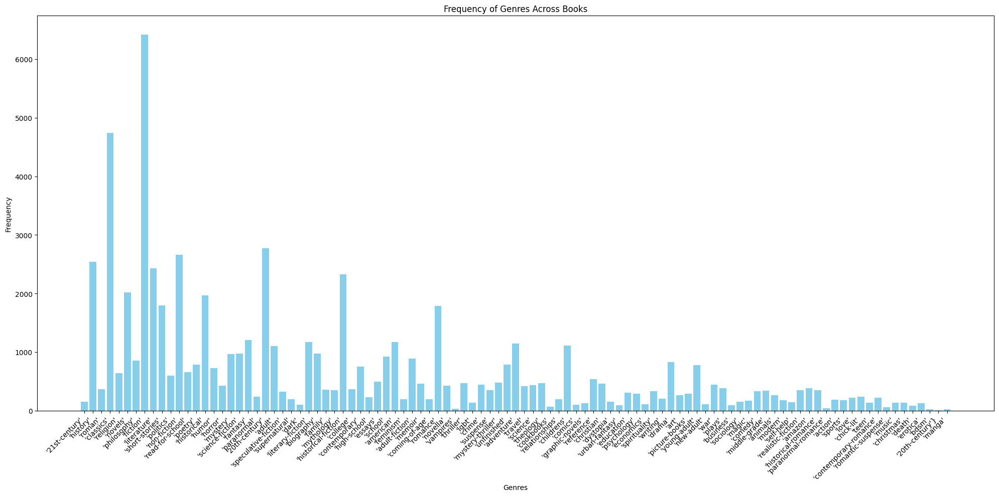

In [20]:
# Extract genre labels and counts from the dictionary
labels = list(genres_dict.keys())
counts = list(genres_dict.values())

# Plotting
plt.figure(figsize=(20, 10))
plt.bar(labels, counts, color='skyblue')
plt.xlabel('Genres')
plt.ylabel('Frequency')
plt.title('Frequency of Genres Across Books')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()


Visualization Charts: This represents the plotting of a bar chart that takes genre data from a dictionary, extracts genre labels and their corresponding frequencies, and then plots a bar chart showing the frequency of each genre across a collection of books.

In [19]:
# Define unnecessary genres
unnecessary_genres = {'21st-century', 'religion', 'novels', 'philosophy', 'literature', 'short-stories', 'non-fiction', 'read-for-school', 'poetry', '20th-century', 'literary-fiction', 'biography', 'college', 'contemporary', 'high-school', 'essays', 'school', 'american', 'feminism', 'memoir', 'novella', 'unfinished', 'travel', 'theology', 'cookbooks', 'reference', 'childrens', 'comics', 'graphic-novels', 'picture-books', 'christian', 'education', 'psychology', 'economics', 'spirituality', 'writing', 'art', 'business', 'sociology', 'middle-grade', 'animals', 'self-help', 'modern', 'manga', 'realistic-fiction', 'amazon', 'sports', 'music', 'christmas'}

# Filter the DataFrame to exclude books that only have unnecessary genre
filter_df = clear_df[clear_df['genres'].apply(lambda x: not all(genre.strip("'") in unnecessary_genres for genre in x.strip('{}').split(', ')))]

# Recalculate genres_dict based on the filtered DataFrame
genres_dict = {}

# Iterate over genres of filtered DataFrame
for genres_str in filter_df['genres']:
    genres_list = genres_str[1:len(genres_str)-1].split(',')
    for genre in genres_list:
        if genre in genres_dict:
            genres_dict[genre] += 1
        else:
            genres_dict[genre] = 1


In [20]:
# Function to remove unnecessary genres from a genre list
def remove_unnecessary_genres(genre_list):
    return [genre.strip("'") for genre in genre_list if genre.strip("'") not in unnecessary_genres]

# Apply the function to the 'genres' column of filtered_df
filter_df.loc[:, 'genres'] = filter_df['genres'].apply(lambda x: remove_unnecessary_genres(x.strip('{}').split(', ')))


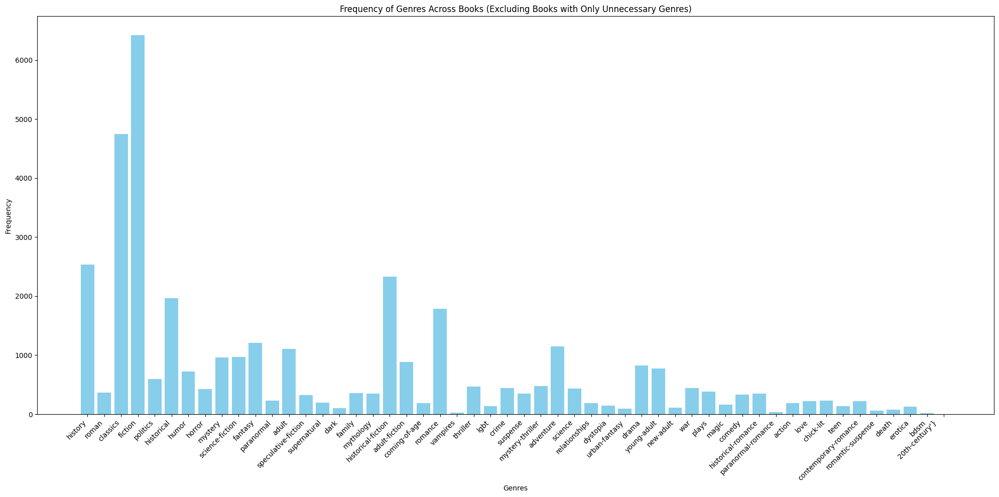

In [28]:
# Flatten the 'genres' lists in filtered_df
flattened_genres = [genre for sublist in filter_df['genres'] for genre in sublist]

# Count the frequencies of genres
genres_counter = Counter(flattened_genres)

# Extract genre labels and counts
labels = list(genres_counter.keys())
counts = list(genres_counter.values())

# Plotting
plt.figure(figsize=(20, 10))
plt.bar(labels, counts, color='skyblue')
plt.xlabel('Genres')
plt.ylabel('Frequency')
plt.title('Frequency of Genres Across Books (Excluding Books with Only Unnecessary Genres)')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()


Visualization:
This section flattens the nested lists of genres into a single list, counts the frequency of each genre, extracts the genre labels and their counts, and then plots a bar chart showing the frequency of each genre across books while excluding books with only unnecessary genres.

In [21]:
#create a way to condense the amount of genes by combining them
genre_mapping2 = { 
    'science fiction': ['science-fiction', 'speculative-fiction','science', 'dystopian'],
    'adventure': ['adventure', 'coming-of-age', 'action' ],
    'fantasy': ['fantasy','mythology', 'urban-fantasy', 'speculative-fiction', 'magic'],
    'horror': ['horror', 'mystery','paranormal', 'speculative-fiction','crime','supernatural','dark','thriller','suspense','mystery-thriller','death'],
    'historical': ['history', 'roman', 'classics', 'war', 'historical', 'historical-fiction' ],
    'comedy': ['comedy', 'humor'],
    'drama': ['politics', 'family', 'plays', 'drama'],
    'romance': ['adult', 'romance', 'lgbt', 'relationships', 'teen', 'love', 'young-adult', 'paranormal-romance', 'new-adult', 'historical-romance', 'chick-lit', 'contemporary-romance', 'romantic-suspense', 'erotica', 'bdsm']

}

In [22]:
#Gets rid of pu nctuation, lower cases letters, gets rid of newlines, and adds genre in front of text
translator = str.maketrans('', '', string.punctuation + '‘’—“”,.')
cleaned_text2 = []
cleaned_genres2 = []

# Assuming random_subset_text is your dataset
for story, genre in zip(filter_df['text'], filter_df['genres']):
    # Check if any subgenre is in the genre_mapping
    aggregated_genre = None
    for mapped_genre, subgenres in genre_mapping2.items():
        for subgenre in subgenres:
            if subgenre in genre:
                aggregated_genre = mapped_genre
                break
        if aggregated_genre:
            break
    
    if aggregated_genre:
        #cleaned_lines = f"<BOS><{aggregated_genre}> " + story.replace('\n', '').translate(translator).lower()
        cleaned_lines =  story.replace('\n', '').translate(translator).lower()
        cleaned_text2.append(cleaned_lines)
        cleaned_genres2.append(aggregated_genre)


# Create dataset with text, genre labels, and genre strings
dataset2 = Dataset.from_dict({"text": cleaned_text2, "genre": cleaned_genres2})

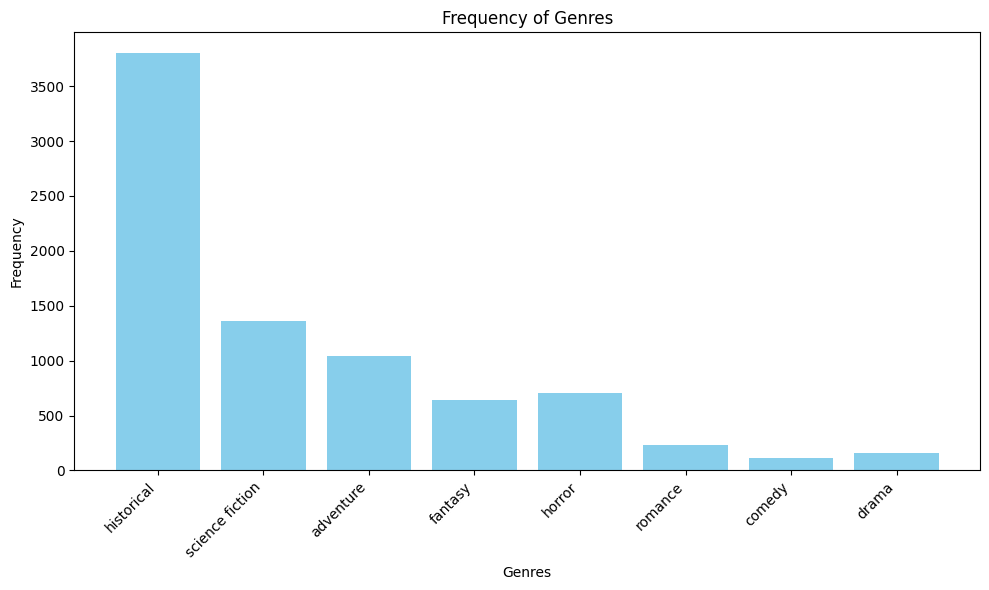

In [31]:
# Count the frequencies of genres
genre_counts = Counter(cleaned_genres2)

# Extract genre labels and counts
labels = list(genre_counts.keys())
counts = list(genre_counts.values())

# Plotting
plt.figure(figsize=(10, 6))
plt.bar(labels, counts, color='skyblue')
plt.xlabel('Genres')
plt.ylabel('Frequency')
plt.title('Frequency of Genres')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()


Visualization:
This is a list of genres that counts the frequency of each genre and extracts the genre labels and their counts, and then plots a bar chart showing the frequency of each genre. This shows the frequncy of condensed genres.

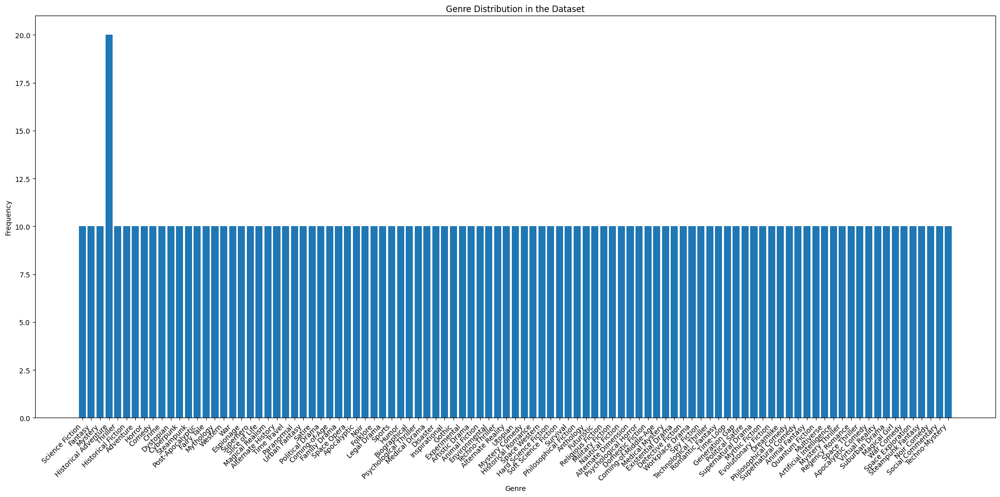

In [30]:
genres = dataset["genre"]
genre_counts = {}
for genre in genres:
    genre_counts[genre] = genre_counts.get(genre, 0) + 1

plt.figure(figsize=(20, 10))
plt.bar(genre_counts.keys(), genre_counts.values())
plt.xlabel('Genre')
plt.ylabel('Frequency')
plt.title('Genre Distribution in the Dataset')
plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better readability
plt.tight_layout()
plt.show()

Visualization:
The frequency of each genre, in the dataset, is calculated and then a bar chart is plotted showing the distribution of genres, where each bar represents a genre, and its height represents the frequency of that genre in the dataset. This for the second dataset.

In [5]:
#again condense genres
genre_mapping = { 
    'science fiction': ['Science Fiction', 'Dystopian','Cyberpunk', 'Post-Apocalyptic', 'Time Travel', 'Space Opera', 'Apocalyptic', 'Alternate Reality','Space Western', 'Utopia', 'Hard Science Fiction', 'Soft Science Fiction' , 'Futuristic', 'Alternate Dimension', 'Time-Loop', 'Quantum Fiction', 'Multiverse', 'Artificial Intelligence', 'Space Thriller', 'Virtual Reality', 'Space Exploration', 'Apocalyptic Comedy' ],
    'adventure': ['Adventure', 'Historical Adventure','Coming-of-Age', 'Slice of Life','Coming-of-Middle-Age','Historical Adventure' ],
    'fantasy': ['Fantasy','Steampunk', 'Fairy Tale','Espionage', 'Superhero','Magical Realism','Romantic Fantasy', 'Mythic Fiction', 'Dreamlike', 'Animal Fantasy', 'Urban Fantasy','Steampunk Fantasy','Magical Girl','Mythology','Folklore'],
    'horror': ['Horror', 'Mystery','Thriller', 'Experimental','Crime','Noir Comedy','Techno-Mystery','Espionage','Noir','Psychological Thriller','Gothic', 'Techno-Thriller','Mystery Comedy', 'Psychological Horror','Detective Fiction', 'Spy Fiction','Technological Thriller', 'Supernatural Drama', 'Supernatural Comedy','Mystery Thriller','Space Thriller','Noir Comedy','Techno-Mystery'],
    'historical': ['Historical Adventure', 'Historical Fiction', 'Historical Romance', 'War'],
    'comedy': ['Comedy', 'Satire', 'Humor','Political Satire', 'Philosophical Comedy', 'Apocalyptic Comedy', 'War Comedy', 'Slice of Life','Noir Comedy', 'Mystery Comedy', 'Supernatural Comedy'],
    'drama': [ 'Political Drama','Family Drama','Legal Drama', 'Medical Drama', 'Disaster','Artistic Drama','Exsistential Drama','Workplace Drama','Suburban Drama', 'Supernatural Drama'],
    'romance': [ 'Regency Romance','Romantic Fantasy','Historical Romance']

}


In [6]:
#again clean text 
translator = str.maketrans('', '', string.punctuation + '‘’—“”,.')
cleaned_text = []
cleaned_genres = []

# Assuming random_subset_text is your dataset
for story, genre in zip(dataset['story'], dataset['genre']):
    # Check if any subgenre is in the genre_mapping
    aggregated_genre = None
    for mapped_genre, subgenres in genre_mapping.items():
        for subgenre in subgenres:
            if subgenre in genre:
                aggregated_genre = mapped_genre
                break
        if aggregated_genre:
            break
    
    if aggregated_genre:
        #cleaned_lines = f"<BOS><{aggregated_genre}> " + story.replace('\n', '').translate(translator).lower()
        cleaned_lines = story.replace('\n', '').translate(translator).lower()
        cleaned_text.append(cleaned_lines)
        cleaned_genres.append(aggregated_genre)


# Convert genre strings to integer labels

# Create dataset with text, genre labels, and genre strings
dataset = Dataset.from_dict({"text": cleaned_text, "genre": cleaned_genres})

In [7]:
dataset["text"]

['in the year 2250 earth had made significant strides in space exploration and interstellar travel the united earth government ueg had established colonies on mars jupiters moon europa and saturns moon titan the advancements in technology and science had led to the creation of the cosmic rift exploration agency crea a governmentfunded organization tasked with exploring the unknown regions of space and discovering new worlds and resources    dr amelia hart a brilliant astrophysicist was the lead scientist at creas headquarters on luna she had devoted her entire life to understanding the mysteries of the universe and had become a pioneer in her field she was determined to uncover the secrets of the cosmic rifts a series of mysterious and seemingly unconnected energy anomalies that had started appearing throughout the galaxy    dr hart assembled a diverse team of experts for her next mission including her trusted secondincommand captain john jack reynolds a seasoned astronaut and veteran 

In [33]:
print(set(cleaned_genres))

{'adventure', 'romance', 'horror', 'historical', 'science fiction', 'drama', 'comedy', 'fantasy'}


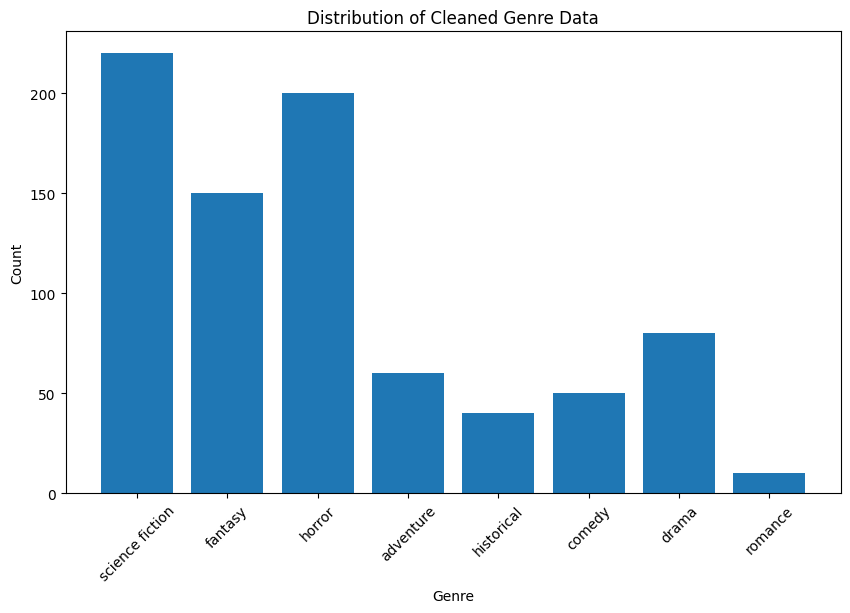

In [34]:
#plot the new condensed genres
genre_counts = {}
for genre in cleaned_genres:
    genre_counts[genre] = genre_counts.get(genre, 0) + 1

# Plot the distribution
plt.figure(figsize=(10, 6))
plt.bar(genre_counts.keys(), genre_counts.values())
plt.xlabel('Genre')
plt.ylabel('Count')
plt.title('Distribution of Cleaned Genre Data')
plt.xticks(rotation=45)  # Rotate genre labels for better visibility
plt.show()

Visualization:
This is a cleaned version of a list of genres that counts the frequency of each genre and extracts the genre labels and their counts, and then plots a bar chart showing the frequency of each genre.

In [25]:
# Combine text from both datasets
combined_text = dataset["text"] + dataset2["text"]

# Create a new dataset with the combined text
combined_dataset = Dataset.from_dict({"text": combined_text})

# Display the combined dataset
print(combined_dataset)

Dataset({
    features: ['text'],
    num_rows: 8858
})


In [81]:
combined_dataset["text"]

['in the year 2250 earth had made significant strides in space exploration and interstellar travel the united earth government ueg had established colonies on mars jupiters moon europa and saturns moon titan the advancements in technology and science had led to the creation of the cosmic rift exploration agency crea a governmentfunded organization tasked with exploring the unknown regions of space and discovering new worlds and resources    dr amelia hart a brilliant astrophysicist was the lead scientist at creas headquarters on luna she had devoted her entire life to understanding the mysteries of the universe and had become a pioneer in her field she was determined to uncover the secrets of the cosmic rifts a series of mysterious and seemingly unconnected energy anomalies that had started appearing throughout the galaxy    dr hart assembled a diverse team of experts for her next mission including her trusted secondincommand captain john jack reynolds a seasoned astronaut and veteran 

In [9]:
def tokenize_function(examples):
    return tokenizer(examples["text"], truncation=True)
    #return tokenizer(examples["text"], max_length=1024, truncation=True, padding=True)
model = GPT2LMHeadModel.from_pretrained("gpt2-medium").to(device)
tokenizer = GPT2Tokenizer.from_pretrained("gpt2")
tokenizer.pad_token = tokenizer.eos_token
tokenized_dataset = combined_dataset.map(tokenize_function)
#tokenized_dataset = combined_dataset.map(tokenize_function,batched=True)#


# Define data collator
data_collator = DataCollatorForLanguageModeling(
    tokenizer=tokenizer,
    mlm=False
)

Map: 100%|██████████| 810/810 [00:02<00:00, 327.38 examples/s]


In [88]:
#experiment
def tokenize_function(examples):
    return tokenizer(examples["text"], truncation=True)
    #return tokenizer(examples["text"], max_length=1024, truncation=True, padding=True)
model = GPT2LMHeadModel.from_pretrained("gpt2").to(device)
tokenizer = GPT2Tokenizer.from_pretrained("gpt2")
tokenizer.pad_token = tokenizer.eos_token
tokenized_dataset = dataset.map(tokenize_function)
#tokenized_dataset = combined_dataset.map(tokenize_function,batched=True)#


# Define data collator
data_collator = DataCollatorForLanguageModeling(
    tokenizer=tokenizer,
    mlm=False
)

Map: 100%|██████████| 810/810 [00:02<00:00, 319.80 examples/s]


Fine-Tuning

For the fine-tuning of the model's hyper parameters, we ended up using 2 epochs since this turned out to be our computational hardware limitation. If a higher epoch number was chosen, the model would never finish due to memory issues.

We also did a batch size of 8 for the exact same reason as the epochs, any number greater than 8 resulted in memory issues.

For save steps, we use a high number instead of the default 500 since we want the model to save not too frequently for speed reasons, and because we had to train many models, so saving progress was not super important for us. However, these models never took an extreme amount of time to run, therefore with a higher save step number, we can make sure the model runs at peak speed and saves only after going through many batches.

Finally we have a save total limit of 2 since we do not want to take up too much space with different checkpoints of the model. Having 2 different ones is more than enough for the amount of models that we needed to train and test with.

Our approach utilized the foundational GPT model and tokenizer, leveraging their robust capabilities. Through meticulous parameter tuning and dataset tokenization, we were able to fine-tune our model effectively, maximizing its performance within our computational constraints.
Had we had better hardware and a more cleaned dataset I belive we could take our model even further.

In [10]:
training_args = TrainingArguments(
    output_dir="./ModelTestCleanedFinalMediumDataset1",
    overwrite_output_dir=True,
    num_train_epochs=2,
    per_device_train_batch_size=8,
    save_steps=10_000,
    save_total_limit=2
)

# Initialize trainer
trainer = Trainer(
    model=model,
    args=training_args,
    data_collator=data_collator,
    train_dataset=tokenized_dataset
)

In [11]:
trainer.train()
train_history = trainer.state.log_history


  0%|          | 0/204 [00:00<?, ?it/s]

OutOfMemoryError: CUDA out of memory. Tried to allocate 512.00 MiB. GPU 0 has a total capacity of 15.99 GiB of which 0 bytes is free. Of the allocated memory 29.54 GiB is allocated by PyTorch, and 6.40 MiB is reserved by PyTorch but unallocated. If reserved but unallocated memory is large try setting PYTORCH_CUDA_ALLOC_CONF=expandable_segments:True to avoid fragmentation.  See documentation for Memory Management  (https://pytorch.org/docs/stable/notes/cuda.html#environment-variables)

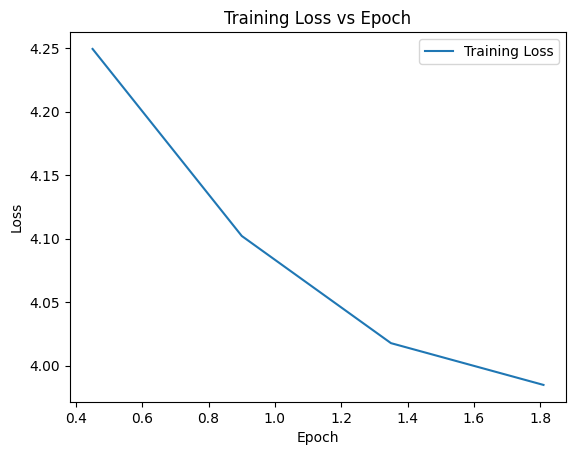

In [30]:
train_data = [{'loss': log['loss'], 'epoch': log['epoch']} for log in train_history if 'loss' in log and 'epoch' in log]

# Extract loss and epoch values
train_losses = [data['loss'] for data in train_data]
epochs = [data['epoch'] for data in train_data]

# Plotting the loss
plt.plot(epochs, train_losses, label='Training Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training Loss vs Epoch')
plt.legend()
plt.show()

In [91]:
# Save the model
trainer.save_model("./ModelTestCleanedFinalDataset1NoTags")
tokenizer.save_pretrained("./ModelTestCleanedFinalDataset1NoTags")

('./ModelTestCleanedFinalDataset1NoTags\\tokenizer_config.json',
 './ModelTestCleanedFinalDataset1NoTags\\special_tokens_map.json',
 './ModelTestCleanedFinalDataset1NoTags\\vocab.json',
 './ModelTestCleanedFinalDataset1NoTags\\merges.txt',
 './ModelTestCleanedFinalDataset1NoTags\\added_tokens.json')

In [41]:
model = GPT2LMHeadModel.from_pretrained("./ModelTestCleanedhopeully")
tokenizer = GPT2Tokenizer.from_pretrained("./ModelTestCleanedhopeully")

model.eval()
# Generate text with the model
prompt = "fantasy"
input_ids = tokenizer.encode(prompt, return_tensors="pt")
attention_mask = torch.ones_like(input_ids)

# Adjust max_length and num_return_sequences based on your preferences
#output = model.generate(input_ids, max_length=150, num_return_sequences=1, do_sample=True, no_repeat_ngram_size=2, top_k=50, top_p=0.95, attention_mask=attention_mask)
output = model.generate(
    input_ids=input_ids, 
    max_length=50, 
    num_return_sequences=1, 
    do_sample=True,  # Enable sampling-based generation
    top_k=50,        # Controls how many of the highest-scoring tokens to keep
    temperature=0.7, # Controls the randomness of the sampling
    attention_mask=attention_mask
)


# Decode and print the generated text
generated_text = tokenizer.decode(output[0], skip_special_tokens=True)
print(generated_text)

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


fantasy in the year 2099 a magical world was born in the arctic sea a place where the ice and snow melted and the sun shone brightly the people of the land lived in harmony and peace the sun was the only light that could reach the


In [12]:
model_path = "./ModelTestCleanedFinalWithDataset1"
tokenizer = GPT2Tokenizer.from_pretrained(model_path)
model = GPT2LMHeadModel.from_pretrained(model_path)

# Set the model to evaluation mode
model.eval()

# Initialize the text generation pipeline
text_generator = pipeline("text-generation", model=model, tokenizer=tokenizer)

# Generate text from a prompt
#prompt = "<BOS><horror>"
prompt = "horror"
generated_text = text_generator(prompt, max_length=50, num_return_sequences=1, truncation=True)[0]['generated_text']

print(generated_text)
print(text_generator("<BOS><horror>"))

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


horror and thriller drama series follows the exploits of a select group of brave travelers from across the globe that set out to find the lost treasures of ancient civilization and navigate treacherous treacherous rivers and treacherous jungles with utmost care and bravery.

Das
[{'generated_text': '<BOS><horror> chapter 1 the aftermath   the quiet life of a young black woman in the aftermath of the city of drumsburg filled with excitement and fear for days a stranger named eileen a tall and lean woman named black'}]


In [42]:
reference_text_scifi = "in the year 2250 earth had made significant strides in space exploration and interstellar travel"
reference_text_fantasy = "in a land far away where the sun shone brighter and the grass was greener there existed a magical forest"
reference_text_horror = "as they began to unravel the threads of this sinister web they found themselves being hunted by a shadowy organization determined to silence them and protect their secrets the group realized that they had become pawns in a deadly game and that the stakes were higher than they could have ever imagined"
reference_text_adventure = "in the bustling city of newbridge there was a legend that had captivated the imagination of the people for generations it was the tale of the lost treasure of avarice a hoard of gold"
reference_text_romance = "lady elizabeth a beautiful young lady was attending a grand ball at the duke of wellingtons estate she was wearing an exquisite gown catching the attention of all the eligible bachelors"
reference_text_comedy = "there were two best friends named chuck and charlie they were as different as chalk and cheese yet they complemented each other perfectly"
reference_text_drama= "the new kid on the block     in a small bustling town in the heart of texas nestled between the rolling hills and vast plains stood a modest office building"
reference_text_historical = "during world war ii in a small corner of the battlefield a group of unlikely heroes resided in fort bumble they were a peculiar bunch"

In [48]:
model_path = "./ModelTestCleanedFinal"
tokenizer = GPT2Tokenizer.from_pretrained(model_path)
model = GPT2LMHeadModel.from_pretrained(model_path)
# Define reference texts
reference_texts = {
    "science_fiction": reference_text_scifi,
    "fantasy": reference_text_fantasy,
    "horror": reference_text_horror,
    "adventure": reference_text_adventure,
    "romance": reference_text_romance,
    "comedy": reference_text_comedy,
    "drama": reference_text_drama,
    "historical": reference_text_historical
}

# Generate text for each genre
genre_bleu_scores = {}
genre_rouge_scores = {}
for genre, reference_text in reference_texts.items():
    # Generate text
    text_generator = pipeline("text-generation", model=model, tokenizer=tokenizer)
    generated_text = text_generator(reference_text, max_length=100, num_return_sequences=1, truncation=True)[0]['generated_text']

    # Tokenize the generated text
    generated_tokens = generated_text.split()

   

    # Calculate ROUGE score
    rouge = Rouge()
    scores = rouge.get_scores(generated_text, reference_text)
    rouge_score = scores[0]['rouge-1']['f']
    genre_rouge_scores[genre] = rouge_score



for genre, rouge_score in genre_rouge_scores.items():
    print(f"{genre.capitalize()} ROUGE Score:", rouge_score)



Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


Science_fiction ROUGE Score: 0.36842104962603883
Fantasy ROUGE Score: 0.4615384579881657
Horror ROUGE Score: 0.8113207498949805
Adventure ROUGE Score: 0.5783132489011469
Romance ROUGE Score: 0.624999995703125
Comedy ROUGE Score: 0.6229508153829616
Drama ROUGE Score: 0.564705878300346
Historical ROUGE Score: 0.5060240926056032


Performance evaluation

For evaluation, we've devised 2 different ways. One of which is human evaluation, so just by reading them we can determine if they are good or not. The other way is the use of a Rouge score which is an overlap measure of the generated text vs a reference text. Higher scores are better.

For human evaluation, we can see that the models are not perfect, in fact they seem to be somewhat inconsistent, especially depending on which model it is that we are using to generate. Sometimes a model performs very well and we see a great generation, one which makes a lot of sense and seems very well written, but usually we see a generation which is just ok, not great, but not horrible. There are cases where the generation is really bad, generating nothing but nonsense and sometimes weird characters. Overall, the models performed decently, the best models had realtively good coherency and understandability, but also would generate bad ones often too.

For the Rouge scores, we can see that the scores are also decent. We had one low score, Science Fiction, which was quite surprising seeing the amount of Science Fiction books there were, as well as the generations for Science Fiction always seemed to be one of the best. Our best score was with Horror which actually made sense because of the amount of Horror books, as well as the generations usually being better than the other genres, besides Science Fiction (usually). Overall, the average Rouge score was 0.5672842860502901 which is a good score to see, showing that the models have an overlap of about 56%. The scores could also be different depending on the reference text that is used, so in all, for the chosen texts and generations, the Rouge score was not too bad.

If we use the Rouge score and human evaluation at the same time, we can actually see the scores in effect more or less. Since a lower score usually shows less similarities resulting in a worse generation, only outlier being Science Fiction usually. For every other score, in the generations we can see tend to follow that score's behavior, where if its lower, the generation usualyl isn't as great, but if it's higher, a better generation tends to happen. Now in our case, with lower ROUGE scores doesnt neccessarily mean a bad thing. The higher it is the less creative and more overfitted the model is. We do want our model to be creative but still undrstand the concept of the genres as well. We belive our model does a good job of that. COuld it be improved? Well yes but so can every model. If we had a bigger dataset, better hardware, and more time our model would be perfect.